# Ideação do projeto para vendas cruzadas

## Recomendação de produtos para pontos de vendas

Este notebook tem como objetivo demonstrar as análises feitas no dataset e apresentar, de forma sequencial, os processos iniciais para a construção do modelo preditivo responsável pelo sistema de recomendação

### Importação das bibliotecas

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from pandas_profiling import ProfileReport

pd.reset_option('^display')
pd.options.display.max_colwidth = None
pd.options.display.max_columns = None

plt.style.use('ggplot')

### Carregamento do dataset

In [2]:
df = pd.read_excel('Data Column Understanding.xlsx')
df

,Column Name,Meaning
0,Doc. Date,Invoice Document Date
1,Material,Material ID
2,Order qty,The number of Material/SKU ordered in one order (for one Wholesaler)
3,Ship-to nu,Wholesaler ID
4,PCS delivered,Pieces delivered of the Material/SKU in one order (different from order quantity as in 1 order quantity can have multiple pieces)
5,HL delivered,Hectolitre delivered of the Material/SKU in one order
6,delivery_days,Delivery days for the Material
7,delivery_flag,"Whether delivered or not ( 0 - not delivered, 1 - delivered)"
8,lead_time_creation_vs_rdd_flag,"Lead time of creation of the document vs delivery days (LOGIC: off/on=""on-trade“ – (Order Creation Date+4(excluding holidays and order creation date)) <= RDD then ""OK"", else ""NOK""\noff/on=“off-trade“– (Order Creation Date+7(excluding holidays and order creation date)) <= RDD then ""OK"", else ""NOK"")"
9,MACO/HL,Contribution per hectoliter of the beer


### Criação do de-para do dataset para facilitar o entendimento das colunas durante a análise

In [3]:
columns_map = {
    'Doc. Date': 'PedidoDataDocumento',
    'Material': 'PedidoProdutoId',
    'Order qty': 'PedidoOrdem',
    'Ship-to nu': 'PedidoAtacadistaId',
    'PCS delivered': 'PedidoQuantidade',
    'HL delivered': 'PedidoHectolitroEntregue',
    'delivery_days': 'PedidoDiasEntrega',
    'delivery_flag': 'PedidoEntregue',
    'lead_time_creation_vs_rdd_flag': 'PedidoLeadTimeEntrega',
    'MACO/HL ': 'PedidoContribuicaoHectolitro',
    'Groupement': 'AtacadistaGrupoImpostoPreco',
    'Postal Code': 'AtacadistaCodigoPostal',
    'Street': 'AtacadistaRuaEndereco',
    'Sous groupement': 'AtacadistaSubgrupo',
    'M2_Territory_ID': 'AtacadistaLocalizacaoId',
    'M1_Territory_ID': 'AtacadistaSubLocalizacaoId',
    'Dépt': 'AtacadistaDepartamento',
    'Brand': 'ProdutoMarca',
    'Subrand': 'ProdutoSubmarca',
    'SEGMENTS : Pils / Spécialités / Superspécialités/Bouteille Young adult': 'ProdutoSegmento2',
    'Container Type': 'ProdutoTipoContainer',
    'Container Size': 'ProdutoTamanhoContainer',
    'Variétés': 'ProdutoVariedade',
    'Segment LE': 'ProdutoSegmento1',
    'Latitude': 'AtacadistaLatitude',
    'Longitude': 'AtacadistaLongitude',
    'Degre Alc': 'ProdutoPercentAlcoolico',
    'TTC': 'PedidoPrecoFinalParaUmProd',
    'Brut + TE': 'PedidoTaxas',
    'DA': 'PedidoTaxaTransporteAereo',
    'Net + TE - Hors majoration de rompu de palette': 'PedidoPrecoLiquidoDescontoPaliteQuebrado'
}

### Carregamento do dataset de pedidos

Carregamento do dataset de pedidos e mapeamento para as colunas traduzidas

In [4]:
df = pd.read_excel('Data.xlsx')
df.drop(columns=['Unnamed: 0'], inplace=True)
df.columns = df.columns.map(columns_map)
df.sort_values(by=['PedidoDataDocumento'], inplace=True)
df.head()

,PedidoDataDocumento,PedidoProdutoId,PedidoOrdem,PedidoAtacadistaId,PedidoQuantidade,PedidoHectolitroEntregue,PedidoDiasEntrega,PedidoEntregue,PedidoLeadTimeEntrega,PedidoContribuicaoHectolitro,AtacadistaGrupoImpostoPreco,AtacadistaCodigoPostal,AtacadistaRuaEndereco,AtacadistaSubgrupo,AtacadistaLocalizacaoId,AtacadistaSubLocalizacaoId,AtacadistaDepartamento,ProdutoMarca,ProdutoSubmarca,ProdutoSegmento2,ProdutoTipoContainer,ProdutoTamanhoContainer,ProdutoVariedade,ProdutoSegmento1,AtacadistaLatitude,AtacadistaLongitude,ProdutoPercentAlcoolico,PedidoPrecoFinalParaUmProd,PedidoTaxas,PedidoPrecoLiquidoDescontoPaliteQuebrado,PedidoTaxaTransporteAereo
72166,2019-08-01,63482,1.0,29804035,70.0,4.2,6,1,1,122.037438,NATIONAL CUSTOMER,53200,RUE DE ROMAINVILLE,NEODIF,3M,3M,53.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,47.7993,-0.7210,5.1,14.806188,12.786,12.338490,0.0
37162,2019-08-01,6013,4.0,29596966,32.0,6.4,7,1,1,159.181849,DISTRIBOISSONS,5000,ROUTE DE BARCELONNETTE,MONTANER,FR01_ON_4000,FR01_ON_4007,50.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,44.5543,6.1627,6.6,62.666534,55.520,52.222112,0.0
37163,2019-08-01,10946,3.0,29596966,210.0,12.6,7,1,1,150.689825,DISTRIBOISSONS,5000,ROUTE DE BARCELONNETTE,MONTANER,FR01_ON_4000,FR01_ON_4007,50.0,LEFFE,LEFFE BLONDE,Spécialités,PERFECT DRAFT,"6,000 L",Blonde,PREMIUM,44.5543,6.1627,6.6,17.894369,15.582,14.911974,0.0
37164,2019-08-01,65642,20.0,29596966,20.0,4.0,7,1,1,NaN,DISTRIBOISSONS,5000,ROUTE DE BARCELONNETTE,MONTANER,FR01_ON_4000,FR01_ON_4007,50.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,44.5543,6.1627,NaN,NaN,NaN,NaN,NaN
37165,2019-08-01,11574,40.0,29596966,320.0,96.0,7,1,1,85.212929,DISTRIBOISSONS,5000,ROUTE DE BARCELONNETTE,MONTANER,FR01_ON_4000,FR01_ON_4007,50.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,44.5543,6.1627,4.8,57.623832,49.710,48.019860,0.0


### Visualização de dados/metadados do dataset

Entendimento do conjunto de features (colunas) do dataset, sua distribuição a análises estatisticas básicas

#### Período de dados do dataset

In [5]:
print('DataInicial: ', df['PedidoDataDocumento'].min())
print('DataFinal: ', df['PedidoDataDocumento'].max())
print('Período: ', (df['PedidoDataDocumento'].max()-df['PedidoDataDocumento'].min()))

DataInicial:  2019-08-01 00:00:00
DataFinal:  2021-02-22 00:00:00
Período:  571 days 00:00:00


#### Quantidade de registros por dia

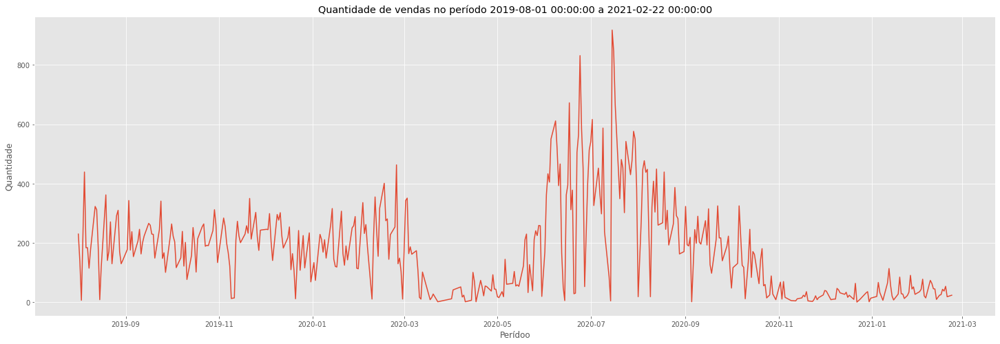

In [6]:
periodo = df.groupby(['PedidoDataDocumento'])['PedidoDataDocumento'].count()
plt.figure(figsize=(25,8))
plt.title('Quantidade de vendas no período {} a {}'.format(df['PedidoDataDocumento'].min(), df['PedidoDataDocumento'].max()))
sns.lineplot(x=periodo.index, y=periodo.values)
plt.xlabel('Perídoo')
plt.ylabel('Quantidade')
plt.show()

#### Quantidade de registros existente por colunas

In [7]:
print('Quantidade máxima de valores para features: ', df.count().values.max())
print('Quantidade mimina de valores para features: ', df.count().values.min())

Quantidade máxima de valores para features:  73670
Quantidade mimina de valores para features:  28316


#### Análise estatistica do dataset

In [8]:
profile = ProfileReport(df, title='Análise estatistica do dataset', explorative=True)

In [9]:
profile

Render HTML: 100%|██████████| 1/1 [00:08<00:00,  8.44s/it]


#### Separação do dataset em grupos contextos menores

In [8]:
df_produto = df[[column for column in df.columns if 'Produto' in column]]
df_atacadista = df[[column for column in df.columns if 'Atacadista' in column]]
df_pedido = df[[column for column in df.columns if 'Pedido' in column]]

### Análise do contexto de produto

* Feature Enginnering
* Identificação de correlação entre variaveis
* Criação de feature para agrupar registros
* Identificação de features que poderão auxiliar na generalização do modelo de recomendação por caracteristicas

#### Identificação de produtos únicos

In [9]:
print('Quantidade de produtos: ', len(df_produto['PedidoProdutoId']))
print('Quantidade de produtos unicos: ', len(df_produto['PedidoProdutoId'].unique()))

Quantidade de produtos:  73670
Quantidade de produtos unicos:  179


Produtos sem caracteristicas

In [10]:
column, _ = list(filter(lambda x: x[1] == True, df_produto.isnull().any().items())).pop(0)
df_produto[df_produto[column].isnull()].head()

,PedidoProdutoId,ProdutoMarca,ProdutoSubmarca,ProdutoSegmento2,ProdutoTipoContainer,ProdutoTamanhoContainer,ProdutoVariedade,ProdutoSegmento1,ProdutoPercentAlcoolico
72166,63482,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.1
37162,6013,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6.6
37164,65642,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
37165,11574,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.8
37166,3372,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.2


Produtos duplicados

In [11]:
column = df_produto['PedidoProdutoId'].unique()
df_produto[df_produto['PedidoProdutoId'] == column.take(11)]

,PedidoProdutoId,ProdutoMarca,ProdutoSubmarca,ProdutoSegmento2,ProdutoTipoContainer,ProdutoTamanhoContainer,ProdutoVariedade,ProdutoSegmento1,ProdutoPercentAlcoolico
37173,59874,TRIPLE KARMELIET,TRIPLE KARMELIET,Craft,BOTTLE VC,"0,330 L",-,SUPER PREMIUM,8.4
37152,59874,TRIPLE KARMELIET,TRIPLE KARMELIET,Craft,BOTTLE VC,"0,330 L",-,SUPER PREMIUM,8.4
37076,59874,TRIPLE KARMELIET,TRIPLE KARMELIET,Craft,BOTTLE VC,"0,330 L",-,SUPER PREMIUM,8.4
37283,59874,TRIPLE KARMELIET,TRIPLE KARMELIET,Craft,BOTTLE VC,"0,330 L",-,SUPER PREMIUM,8.4
37733,59874,TRIPLE KARMELIET,TRIPLE KARMELIET,Craft,BOTTLE VC,"0,330 L",-,SUPER PREMIUM,8.4
...,...,...,...,...,...,...,...,...,...
317,59874,TRIPLE KARMELIET,TRIPLE KARMELIET,Craft,BOTTLE VC,"0,330 L",-,SUPER PREMIUM,8.4
69359,59874,TRIPLE KARMELIET,TRIPLE KARMELIET,Craft,BOTTLE VC,"0,330 L",-,SUPER PREMIUM,NaN
386,59874,TRIPLE KARMELIET,TRIPLE KARMELIET,Craft,BOTTLE VC,"0,330 L",-,SUPER PREMIUM,8.4
69398,59874,TRIPLE KARMELIET,TRIPLE KARMELIET,Craft,BOTTLE VC,"0,330 L",-,SUPER PREMIUM,8.4


Remoção de produtos duplicados/sem caracteristicas

In [12]:
df_produto = df_produto.dropna()
df_produto = df_produto.drop_duplicates(subset=['PedidoProdutoId'])
df_produto.head()

,PedidoProdutoId,ProdutoMarca,ProdutoSubmarca,ProdutoSegmento2,ProdutoTipoContainer,ProdutoTamanhoContainer,ProdutoVariedade,ProdutoSegmento1,ProdutoPercentAlcoolico
37163,10946,LEFFE,LEFFE BLONDE,Spécialités,PERFECT DRAFT,"6,000 L",Blonde,PREMIUM,6.6
37167,20614,LEFFE,LEFFE RUBY,Super Spécialités,PERFECT DRAFT,"6,000 L",Ruby,PREMIUM,5.0
37172,30822,LEFFE,LEFFE RUBY,Super Spécialités,BOTTLE VC,"0,330 L",Ruby,PREMIUM,5.0
37173,59874,TRIPLE KARMELIET,TRIPLE KARMELIET,Craft,BOTTLE VC,"0,330 L",-,SUPER PREMIUM,8.4
37176,61629,KWAK,KWAK,Craft,PERFECT DRAFT,"6,000 L",-,SUPER PREMIUM,8.4


#### Ajuste na feature de ProdutoTamahoContainer

Transformando a variavel categorica em numérica

In [13]:
df_produto['ProdutoTamanhoContainer'].apply(lambda x: x.replace('L', '').replace(',', '.').strip()).unique()
df_produto['ProdutoTamanhoContainer'] = df_produto['ProdutoTamanhoContainer'].apply(lambda x: round(float(x.replace('L', '').replace(',', '.').strip()),2))

Removendo espaços no começo e final das variaveis categorias a fim de evitar que campos possuam descrição diferente por causo do espaço

In [14]:
columns = [column for column in df_produto.columns if df_produto[column].dtype == object]
df_produto[columns] = df_produto[columns].applymap(str.strip)

In [15]:
df_produto.head()

,PedidoProdutoId,ProdutoMarca,ProdutoSubmarca,ProdutoSegmento2,ProdutoTipoContainer,ProdutoTamanhoContainer,ProdutoVariedade,ProdutoSegmento1,ProdutoPercentAlcoolico
37163,10946,LEFFE,LEFFE BLONDE,Spécialités,PERFECT DRAFT,6.00,Blonde,PREMIUM,6.6
37167,20614,LEFFE,LEFFE RUBY,Super Spécialités,PERFECT DRAFT,6.00,Ruby,PREMIUM,5.0
37172,30822,LEFFE,LEFFE RUBY,Super Spécialités,BOTTLE VC,0.33,Ruby,PREMIUM,5.0
37173,59874,TRIPLE KARMELIET,TRIPLE KARMELIET,Craft,BOTTLE VC,0.33,-,SUPER PREMIUM,8.4
37176,61629,KWAK,KWAK,Craft,PERFECT DRAFT,6.00,-,SUPER PREMIUM,8.4


#### Visualização das distribuição das variaveis

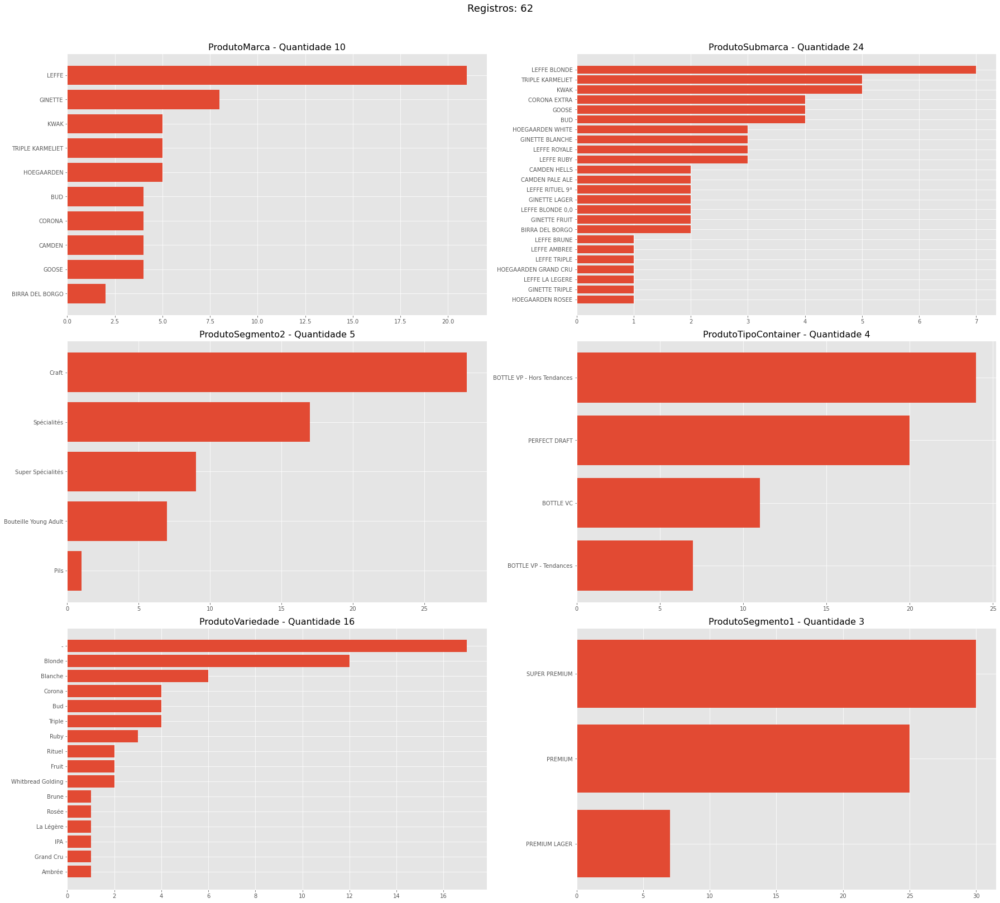

In [16]:
n_rows = np.math.ceil(len(columns) / 2)

fig, ax = plt.subplots(nrows=n_rows, ncols=2, figsize=(25,22))
for i, column in enumerate(columns):
    counts = df_produto[column].value_counts().sort_values()
    ax.flat[i].barh(counts.index, counts.values)
    ax.flat[i].set_title(f'{column} - Quantidade {len(counts)}', size=16)

plt.suptitle(f'Registros: {len(df_produto)}', y=1.02, size=18)
plt.tight_layout()
plt.show()

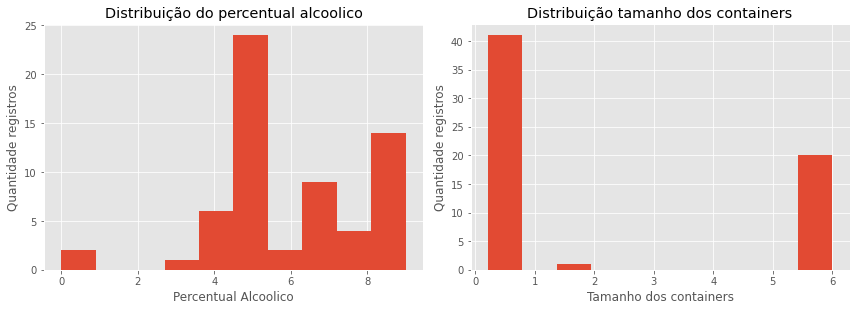

In [17]:
plt.figure(figsize=(12,8))
plt.subplot(221)
plt.title('Distribuição do percentual alcoolico')
plt.hist(df_produto['ProdutoPercentAlcoolico'])
plt.xlabel('Percentual Alcoolico')
plt.ylabel('Quantidade registros')

plt.subplot(222)
plt.title('Distribuição tamanho dos containers')
plt.hist(df_produto['ProdutoTamanhoContainer'])
plt.xlabel('Tamanho dos containers')
plt.ylabel('Quantidade registros')

plt.tight_layout()
plt.show()


#### Enriquecimento do dataset com base na submarca

Carregando a descrição do produto com base na extração de dados do site da https://www.ambev.com.br/marcas

In [22]:
df_produto_detalhe = pd.read_json('produto_caracteristica.json')

Extraindo features para o dataset de detalhes a fim de vincular esses dados ao dataset principal do produto

In [23]:
def extract_brand(link: str):
    links = link.replace('https://www.ambev.com.br/marcas/cervejas/', '').split('/')
    links = [lk for lk in links if len(lk) > 0]

    if len(links) > 1:
        brand, _ = links
        links = [brand]

    return ''.join(links).upper().replace('-', ' ')

def extract_subbrand(link: str):
    links = link.replace('https://www.ambev.com.br/marcas/cervejas/', '').split('/')
    links = [lk for lk in links if len(lk) > 0]

    if len(links) > 1:
        brand, sub = links
        if sub.startswith(brand):
            links = [sub]

    return ''.join(links).upper().replace('-', ' ')

In [24]:
def extract_ingredients(ingredients: str) -> list:

    if not ingredients:
        return []

    ingredients = ingredients.lower()
    ingredients = ingredients.replace('ingredientes', '')
    ingredients = ingredients.replace(':', '')
    ingredients = ingredients.replace(' e ', ', ')
    ingredients = ingredients.replace('.', '')
    return ingredients.split(',')

def extract_alergic(alergic: str) -> list:

    if not alergic:
        return []

    alergic = alergic.lower()
    alergic = alergic.replace('contém', '')
    alergic = alergic.replace('contem', '')
    alergic = alergic.replace(':', '')
    alergic = alergic.replace(' e ', ', ')
    alergic = alergic.replace('.', '')
    return alergic.lower().split(',')


Ajustando o dataset, alguns registros estão com os valores das colunas descrição, ingredientes e alergicos trocados.

In [25]:
filter = df_produto_detalhe['alergicos'].notna() & df_produto_detalhe['alergicos'].str.contains('INGREDIENTES')

In [26]:
df_produto_detalhe.loc[filter, 'descricao'] = df_produto_detalhe[filter]['ingredientes']
df_produto_detalhe.loc[filter, 'ingredientes'] = df_produto_detalhe[filter]['alergicos']
df_produto_detalhe.loc[filter, 'alergicos'] = ''

In [27]:
df_produto_detalhe['ProdutoMarca'] = df_produto_detalhe['url'].apply(extract_brand)
df_produto_detalhe['ProdutoSubmarca'] = df_produto_detalhe['url'].apply(extract_subbrand)
df_produto_detalhe['ingredientes'] = df_produto_detalhe['ingredientes'].apply(extract_ingredients)
df_produto_detalhe['alergicos'] = df_produto_detalhe['alergicos'].apply(extract_alergic)
df_produto_detalhe.drop(columns=['url'], inplace=True)

In [28]:
df_produto_detalhe.head()

,descricao,ingredientes,alergicos,harmonizacao,temperatura,ibu,ProdutoMarca,ProdutoSubmarca
0,"A Cerveja Adriática 600ml foi criada pelo alemão Henrique Thielen, um visionário cervejeiro do início do século XX. Ela teve seu nome em homenagem à cervejaria que traduz toda uma era de tradição passada de pai para filho. Hoje, conhecida como a irmã mais velha da Original, ela é uma pedida certa para a mesa de bar. Reconhecidamente uma cerveja puro malte de alta qualidade, fácil de beber e com aromas especiais que dão um toque equilibrado.","[ água, malte, lúpulo]","[ cevada, glúten]",None,None,NaN,ADRIATICA,ADRIATICA
1,"Puro malte argentino inspirado no frescor das Cordilheiras dos Andes. Cerveja mais fresca, inspirada nas cordilheiras. Ingredientes argentinos: malte e lúpulo argentinos.","[ água, malte, lúpulo]","[ cevada, glúten]","Harmoniza com churrasco, choripan e queijos leves",None,NaN,ANDES,ANDES
2,"Beck’s é uma legítima German Lager Puro Malte, que segue à risca a lei da pureza da cerveja alemã desde 1873. Seu IBU (unidade internacional de amargor) é 20. O resultado é uma cerveja de amargor intenso, sabor marcante e excepcional pureza.Ela é provocante, cheia de personalidade e com um sabor característico e único. A cerveja alemã mais vendida no mundo.","[ água, malte, lúpulo]","[ cevada, glúten]","Por ser uma cerveja tradicional da Alemanha, harmoniza bem com os principais pratos alemães. Mas para quem busca alimentos mais leves ela também harmoniza com peixes grelhados, frutos do mar e saladas por conta da sua alta refrescância.",0-4 ºC,20.0,BECKS,BECKS
3,"Produzida e vendida somente no Piauí, ideal para aliviar o B-R-O-BRÓ sem fim do estado. Leva na receita caju plantado e colhido por pequenos produtores do estado, adquirido sem intermédios gerando renda para as regiões menos favorecidas e diminuindo o desperdício do insumo. Feita por piauienses e pensada para piauiense, sua receita é desenvolvida com ingredientes que a tornam leve e refrescante e com o sabor que o Piauí gosta.","[ lúpulo, água, malte, milho, suco de caju]","[ cevada, glúten]","A Berrió harmoniza bem com paçoca, arroz Maria Isabel e Capote frito.",0-4 ºC,7.0,BERRIO DO PIAUI,BERRIO DO PIAUI
4,"O processo de produçãoda Budweiser é diferenciado, por utilizar lascas de Beechwood (madeira especial) durante os processos de fermentação e maturação. O resultado é um cerveja de sabor único e com equilíbrio perfeito: marcante no início e suave no final.","[ água, malte, arroz, lúpulo]","[ cevada, glúten]","O sabor marcante no começo e suave no final de Budweiser pede que ela harmonize com hambúrguer clássico, presunto cozido e mix de castanhas.",0-4 ºC,10.0,BUDWEISER,BUDWEISER


In [31]:
df_produto_detalhe.to_json('produto_caracteristica.json',orient='records')

Conversão dos valores das colunas ingredientes e alergicos em colunas 

In [32]:
from sklearn.preprocessing import MultiLabelBinarizer

ingrediente_label = MultiLabelBinarizer()
labels = ingrediente_label.fit_transform(df_produto_detalhe['ingredientes'])

In [33]:
df_produto_detalhe = pd.concat([df_produto_detalhe, pd.DataFrame(labels, columns=ingrediente_label.classes_)], axis=1)
df_produto_detalhe.drop(columns=['ingredientes'], inplace=True)

In [34]:
alergicos_label = MultiLabelBinarizer()
labels = alergicos_label.fit_transform(df_produto_detalhe['alergicos'])

In [35]:
df_produto_detalhe = pd.concat([df_produto_detalhe, pd.DataFrame(labels, columns=alergicos_label.classes_)], axis=1)
df_produto_detalhe.drop(columns=['alergicos'], inplace=True)

In [36]:
df_produto_detalhe.head(1)

,descricao,harmonizacao,temperatura,ibu,ProdutoMarca,ProdutoSubmarca,a goose island black trippel com bananas passas,arroz,aveia,açúcar,açúcar de cana,açúcar mascavo,carboidratos,casca de laranja,cascas de laranja,castanha de baru (típica do cerrado mineiro),castanha do pará,cereais não malteados,cerveja,cevada,corante caramelo iii ins 150c,estabilizante pectina de fruta,extrato aromático de hibisco,extrato de abacaxi,extrato de amêndoa,extrato de cacau,extrato de café,extrato de casca de laranja,extrato de coentro,extrato de laranja,extrato de limão,extrato de uva passa,extrato natural de café,extratos naturais de laranja,fermento,flocos de aveia,fécula de mandioca,levedura,leveduras,lúpulo,lúpulo nobre,malte,malte de cevada,malte de trigo,maltes de cevada,mandioca,maturada por 5 meses em barris de carvalho que antes foram utilizados para maturar cachaça mineira,mel,milho,polpa de uvaia,rapadura,semente de coentro,suco de amora do mato,suco de caju,suco de cambuci,suco de cereja-do-rio-grande,suco de graviola,suco de grumixama,trigo,água,cerveja produzida através de uma parceria entre a cervejaria wäls,cevada,glúten,glúten pode conter trigo
0,"A Cerveja Adriática 600ml foi criada pelo alemão Henrique Thielen, um visionário cervejeiro do início do século XX. Ela teve seu nome em homenagem à cervejaria que traduz toda uma era de tradição passada de pai para filho. Hoje, conhecida como a irmã mais velha da Original, ela é uma pedida certa para a mesa de bar. Reconhecidamente uma cerveja puro malte de alta qualidade, fácil de beber e com aromas especiais que dão um toque equilibrado.",None,None,NaN,ADRIATICA,ADRIATICA,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,1,0


Junção da descrição e da harmonização a fim de agrupar esses dados para criação de um bag of words

In [37]:
df_produto_detalhe['Descricao+Hamonizacao'] = df_produto_detalhe['descricao'] + '. ' + df_produto_detalhe['harmonizacao']
df_produto_detalhe.drop(columns=['descricao', 'harmonizacao'], inplace=True)

In [38]:
df_produto_detalhe.head(1)

,temperatura,ibu,ProdutoMarca,ProdutoSubmarca,a goose island black trippel com bananas passas,arroz,aveia,açúcar,açúcar de cana,açúcar mascavo,carboidratos,casca de laranja,cascas de laranja,castanha de baru (típica do cerrado mineiro),castanha do pará,cereais não malteados,cerveja,cevada,corante caramelo iii ins 150c,estabilizante pectina de fruta,extrato aromático de hibisco,extrato de abacaxi,extrato de amêndoa,extrato de cacau,extrato de café,extrato de casca de laranja,extrato de coentro,extrato de laranja,extrato de limão,extrato de uva passa,extrato natural de café,extratos naturais de laranja,fermento,flocos de aveia,fécula de mandioca,levedura,leveduras,lúpulo,lúpulo nobre,malte,malte de cevada,malte de trigo,maltes de cevada,mandioca,maturada por 5 meses em barris de carvalho que antes foram utilizados para maturar cachaça mineira,mel,milho,polpa de uvaia,rapadura,semente de coentro,suco de amora do mato,suco de caju,suco de cambuci,suco de cereja-do-rio-grande,suco de graviola,suco de grumixama,trigo,água,cerveja produzida através de uma parceria entre a cervejaria wäls,cevada,glúten,glúten pode conter trigo,Descricao+Hamonizacao
0,None,NaN,ADRIATICA,ADRIATICA,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,1,0,NaN


Criação do bag of words 

In [39]:
import spacy

nlp = spacy.load('pt_core_news_lg')

In [40]:
nlp.pipe_names

['tok2vec', 'morphologizer', 'parser', 'attribute_ruler', 'lemmatizer', 'ner']

In [41]:
from sklearn.impute import SimpleImputer

imputer = SimpleImputer(fill_value='', strategy='constant')

df_produto_detalhe['Descricao+Hamonizacao'] = imputer.fit_transform(df_produto_detalhe['Descricao+Hamonizacao'].values.reshape(-1,1))

In [42]:
def get_token(sentence: str):
    return [word.lemma_ for word in nlp(sentence) if not (word.is_stop or
                                                        word.like_num or
                                                        word.is_punct or
                                                        word.is_space or
                                                        len(word) == 1)]

In [43]:
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer

bag_of_word = CountVectorizer(tokenizer=get_token)
bow = bag_of_word.fit_transform(df_produto_detalhe['Descricao+Hamonizacao'])

In [44]:
len(bag_of_word.vocabulary_)

574

In [45]:
tf_idf = TfidfVectorizer(tokenizer=get_token, vocabulary=bag_of_word.vocabulary_)
tf = tf_idf.fit_transform(df_produto_detalhe['Descricao+Hamonizacao'])

In [46]:
tfidf_df = pd.DataFrame(tf.toarray(), index=df_produto_detalhe.index)
tfidf_df.columns = tf_idf.get_feature_names()
tfidf_df.head()

,210ml,350ml,473ml,600ml,abacaxi,acentuar,acessível,acidez,adocicar,adquirir,aftertaste,agricultor,ajudar,alcoólico,alemanha,alemao,alemão,alho,alimento,aliviar,alto,amanhã,amarelar,amargo,amargor,amendoim,amigo,amigos.a,anchova,andar,animar,ano,antarctica,anteceder,análise,aparência,aperfeiçoar,apimentar,appia,apreciador,aproveitar,argentino,aromar,aromático,arroz,arte,artesanal,artois,assegurar,atendimento,autêntico,ave,award,b-r-o-bró,bacalhau,baixo,balancear,balançar,banana,batata,beber,bebido,beck,beechwood,beer,belga,belo,bernardo,berrió,bohemia,bohemian,bolo,bom,boteco,brahma,branco,brasil,brasileiro,brie,brilhante,brindar,brinde,budweiser,buscar,bélgica,cadeia,café,caju,caloria,camarão,capotar,caprese,caprichar,caracterizar,característico,caracu,caramelada,caramelo,caranguejo,carboidratos,carbonatar,carbonatação,carnar,carne,caro,casar,cascar,castanho,catarino,cear,cearences,celebrar,cercar,cervecería,cervejar,cervejeiro,cevar,ceviche,cevivhe,cheio,chocolate,choripan,churrasco,ciar,cidade,citricidade,claro,clima,clássico,coentro,coisa,colher,colhido,colorar,coloração,combinar,combinação,comedir,comido,companhia,complementar,completamente,comum,condimentar,conferir,considerar,consistente,contar,conter,contrastar,controlo,convite,copar,cor,cordilheira,corona,coronita,corpo,cortar,coxa,cozer,cremar,cremoso,criar,crispy,cristalino,croquete,cultivar,cultura,cup,curtir,cítrico,daqui,deixar,democrático,descer,desconectar,descontrair,desenvolver,desenvolvido,desenvolvimento,desperdício,destacar,detalhar,diferencial,diferenciar,diferente,diminuir,distribuir,diversão,doce,dose,dourar,dulçor,duradouro,durante,durar,economia,elaborar,embutir,encontrar,encorpar,energia,engajamento,engarrafar,entender,equilibrar,equilíbrio,escandinavo,escolher,escuro,esmerar,especial,especialmente,espumar,esquecer,essência,estar,esterificar,estilar,estrelo,excelente,excelência,excepcional,exclusivamente,exclusivo,experimentar,experiência,export,exportar,expressão,extra,extremamente,exótico,fama,família,fatiar,favorecido,favorito,fazer,feijoada,feito,fermentação,filtrar,floral,florir,fomentar,forte,frango,fresco,frescor,fritar,frito,fritura,frutar,fruto,fábrica,fórmula,galera,galinhada,ganhar,garantir,gargalo,garrafa,gastronomia,gelar,gerar,german,glutén,glúten,goiano,goiá,gold,gordura,gorduroso,gostar,gostoso,graduação,grelhar,habitante,hambúrguer,happy,harmonizar,harmonização,haver,henrique,herança,herbal,hoegaarden,hoje,homenagear,hour,ibu,ideal,igualmente,importar,indispensavel,ingrediente,inovador,inspirar,insumo,intacto,intenso,interior,intermédio,internacional,investimento,início,isabel,juntar,kremer,lager,lançar,laranjeira,laranjo,lascar,latim,lato,legítimo,lei,lembrar,lentamente,leuven,levar,leve,levedura,levemente,leveza,levinha,ligeiramente,limpar,limão,localizar,long,lula,läger,límpido,líquido,lúpulo,madeirar,magnífico,magro,maltar,malte,malzbier,mandioca,manter,mar,maranhense,maranhão,marcante,marcar,maria,marisco,massa,maturação,matéria,mel,melhor,melhorar,mercar,mesmo,michelob,minar,mix,modelar,moderar,momento,mundo,munich,médio,médio-baixo,méxico,nascer,nascido,natal,natural,neck,nobre,nome,nordeste,noto,nutritivo,nuts,optar,orgulhar,original,originalmente,ostra,outro,pack,paladar,palavra,pamonha,par,parmesão,passar,pastelzinho,patagonia,paulista,paulo,paçoca,pedir,peixe,pensar,pequeno,pequi,perfazer,perfeitamente,perfeito,permitir,pernabucanos,pernambuco,pernil,persistente,persistir,personalidade,pesar,petisco,piauiense,piauí,pilsen,pilsener,pilsner,plantar,polar,polvo,popular,possuir,praia,prato,prazer,preciosidade,predominante,predominar,preparar,presentar,preservar,prestigiar,presunto,preto,preço,primo,principal,princípio,processar,processo,procurar,produtivo,produtor,produzir,produçãoda,profundo,promover,pronunciar,proporcionar,proteína,provocante,pureza,pureza.ela,puro,pé,pôr,qualidade,quebrar,queijar,queijo,quentar,rachar,raiz,raspar,realçar,receber,receitar,reconhecido,redondo,referenciar,refinar,reforçar,refrescante,refrescar

#### Criando um modelo dummy

Criar um modelo base para servir como base-line para comparação com os próximos modelos

Criação de features utilizando LabelEncoder para transformar as variaveis categoricas em numericas

In [47]:
from sklearn.preprocessing import LabelEncoder

encoders_produto = {}
df_produto_encoder = pd.DataFrame(df_produto[['PedidoProdutoId', 'ProdutoTamanhoContainer', 'ProdutoPercentAlcoolico']])

for column in columns:
    encoders_produto[column] = LabelEncoder()
    df_produto_encoder[column] = encoders_produto[column].fit_transform(df_produto[column].values.ravel())

df_produto_encoder.head()


,PedidoProdutoId,ProdutoTamanhoContainer,ProdutoPercentAlcoolico,ProdutoMarca,ProdutoSubmarca,ProdutoSegmento2,ProdutoTipoContainer,ProdutoVariedade,ProdutoSegmento1
37163,10946,6.00,6.6,8,15,3,3,3,0
37167,20614,6.00,5.0,8,21,4,3,13,0
37172,30822,0.33,5.0,8,21,4,0,13,0
37173,59874,0.33,8.4,9,23,1,0,0,2
37176,61629,6.00,8.4,7,13,1,3,0,2


In [48]:
from sklearn.preprocessing import StandardScaler

scalers_produto = {}
df_produto_scaler = pd.DataFrame(df_produto_encoder['PedidoProdutoId'])

for column in df_produto_encoder.drop(columns=['PedidoProdutoId']).columns:
    scalers_produto[column] = StandardScaler()
    df_produto_scaler[column] = scalers_produto[column].fit_transform(df_produto_encoder[column].values.reshape(-1,1))

df_produto_scaler.head()

,PedidoProdutoId,ProdutoTamanhoContainer,ProdutoPercentAlcoolico,ProdutoMarca,ProdutoSubmarca,ProdutoSegmento2,ProdutoTipoContainer,ProdutoVariedade,ProdutoSegmento1
37163,10946,1.445750,0.366245,0.862907,0.475924,0.842404,1.272825,-0.371454,-1.151584
37167,20614,1.445750,-0.442920,0.862907,1.323023,1.599346,1.272825,1.703332,-1.151584
37172,30822,-0.711003,-0.442920,0.862907,1.323023,1.599346,-1.417464,1.703332,-1.151584
37173,59874,-0.711003,1.276556,1.239669,1.605390,-0.671481,-1.417464,-0.993889,0.979705
37176,61629,1.445750,1.276556,0.486145,0.193558,-0.671481,1.272825,-0.993889,0.979705


Levantando correlação das variaveis para identificar quais possuem maior correlação.

<AxesSubplot:>

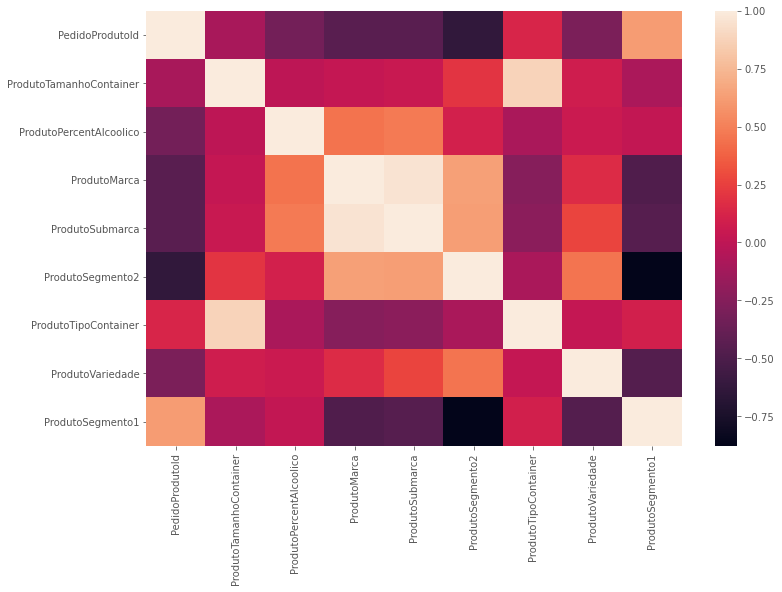

In [49]:
corr = df_produto_scaler.corr()

plt.figure(figsize=(12,8))
sns.heatmap(corr)

In [50]:
corr[(corr.abs() > 0.75) & (corr.abs() != 1.0)]

,PedidoProdutoId,ProdutoTamanhoContainer,ProdutoPercentAlcoolico,ProdutoMarca,ProdutoSubmarca,ProdutoSegmento2,ProdutoTipoContainer,ProdutoVariedade,ProdutoSegmento1
PedidoProdutoId,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
ProdutoTamanhoContainer,NaN,NaN,NaN,NaN,NaN,NaN,0.877584,NaN,NaN
ProdutoPercentAlcoolico,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
ProdutoMarca,NaN,NaN,NaN,NaN,0.956884,NaN,NaN,NaN,NaN
ProdutoSubmarca,NaN,NaN,NaN,0.956884,NaN,NaN,NaN,NaN,NaN
ProdutoSegmento2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.877348
ProdutoTipoContainer,NaN,0.877584,NaN,NaN,NaN,NaN,NaN,NaN,NaN
ProdutoVariedade,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
ProdutoSegmento1,NaN,NaN,NaN,NaN,NaN,-0.877348,NaN,NaN,NaN


In [51]:
corr_columns = []
for column in corr[(corr.abs() > 0.75) & (corr.abs() != 1.0)].unstack().dropna().drop_duplicates().index.map(list):
    corr_columns += (column)

print(corr_columns)

['ProdutoTamanhoContainer', 'ProdutoTipoContainer', 'ProdutoMarca', 'ProdutoSubmarca', 'ProdutoSegmento2', 'ProdutoSegmento1']


In [52]:
corr_columns = ['PedidoProdutoId', 'ProdutoMarca', 'ProdutoSegmento2', 'ProdutoTipoContainer']

In [53]:
features = df_produto.drop(columns=corr_columns)
features

,ProdutoSubmarca,ProdutoTamanhoContainer,ProdutoVariedade,ProdutoSegmento1,ProdutoPercentAlcoolico
37163,LEFFE BLONDE,6.00,Blonde,PREMIUM,6.6
37167,LEFFE RUBY,6.00,Ruby,PREMIUM,5.0
37172,LEFFE RUBY,0.33,Ruby,PREMIUM,5.0
37173,TRIPLE KARMELIET,0.33,-,SUPER PREMIUM,8.4
37176,KWAK,6.00,-,SUPER PREMIUM,8.4
...,...,...,...,...,...
2460,BIRRA DEL BORGO,6.00,-,SUPER PREMIUM,5.0
4204,LEFFE BLONDE,0.33,Blonde,PREMIUM,6.6
70269,KWAK,0.75,-,SUPER PREMIUM,8.4
20068,BIRRA DEL BORGO,6.00,-,SUPER PREMIUM,5.0


Redução de dimensionalidade para possibitar a visualização

In [54]:
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA

In [55]:
pca = PCA(n_components=2)
components = pca.fit_transform(df_produto_scaler.drop(columns=corr_columns))
print(pca.explained_variance_ratio_)

[0.38299118 0.23575135]


In [56]:
def quantidade_cluster(data, max_cluster):
    wcss = []
    for n in range(2, max_cluster):
        kmeans = KMeans(n_clusters=n)
        kmeans.fit(X=data)
        wcss.append(kmeans.inertia_)

    return wcss

def quantidade_cluster_otima(wcss):
    x1, y1 = 2, wcss[0]
    x2, y2 = 20, wcss[len(wcss)-1]

    distances = []
    for i in range(len(wcss)):
        x0 = i+2
        y0 = wcss[i]
        numerator = abs((y2-y1)*x0 - (x2-x1)*y0 + x2*y1 - y2*x1)
        denominator = np.sqrt((y2 - y1)**2 + (x2 - x1)**2)
        distances.append(numerator/denominator)
    
    return distances.index(max(distances)) + 2

Levantando quantos cluster seriam o ideal para atender a quantidade de features

In [57]:
wcss = quantidade_cluster(components, 21)
n_cluster = quantidade_cluster_otima(wcss)
print(n_cluster)

5


In [58]:
knn = KMeans(n_clusters=n_cluster)
labels = knn.fit_predict(components)

Visualização dos agrupamentos

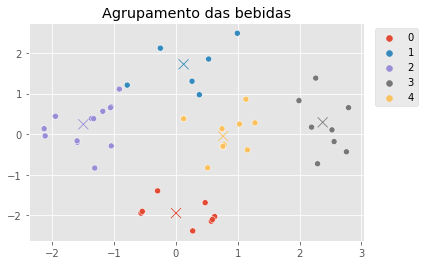

In [59]:
palette = { label: f'C{i}' for i, label in enumerate(range(knn.n_clusters))}

plt.title('Agrupamento das bebidas')
ax = sns.scatterplot(x=components[:,0], y=components[:,1], hue=knn.labels_, palette=palette)
sns.scatterplot(x=knn.cluster_centers_[:,0], y=knn.cluster_centers_[:,1], hue=range(knn.n_clusters), s=100, palette=palette, legend=False, ax=ax, marker='x')
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left')
plt.show()

In [60]:
df_produto['cluster'] = labels

In [61]:
df_produto.head()

,PedidoProdutoId,ProdutoMarca,ProdutoSubmarca,ProdutoSegmento2,ProdutoTipoContainer,ProdutoTamanhoContainer,ProdutoVariedade,ProdutoSegmento1,ProdutoPercentAlcoolico,cluster
37163,10946,LEFFE,LEFFE BLONDE,Spécialités,PERFECT DRAFT,6.00,Blonde,PREMIUM,6.6,4
37167,20614,LEFFE,LEFFE RUBY,Super Spécialités,PERFECT DRAFT,6.00,Ruby,PREMIUM,5.0,3
37172,30822,LEFFE,LEFFE RUBY,Super Spécialités,BOTTLE VC,0.33,Ruby,PREMIUM,5.0,3
37173,59874,TRIPLE KARMELIET,TRIPLE KARMELIET,Craft,BOTTLE VC,0.33,-,SUPER PREMIUM,8.4,0
37176,61629,KWAK,KWAK,Craft,PERFECT DRAFT,6.00,-,SUPER PREMIUM,8.4,0


#### Metrica do agrupamento dos produtos para similaridade

In [62]:
from sklearn.metrics import silhouette_score

print('Silhouette Score: ', silhouette_score(components, labels))

Silhouette Score:  0.5717194314695264


### Buscando produtos similares

#### Com base em um produto existente

In [63]:
produto_id = np.random.choice(df_produto['PedidoProdutoId'], 1)[0]
cluster = df_produto[df_produto['PedidoProdutoId'] == produto_id]['cluster'].values[0]

print(cluster)

df_produto[df_produto['cluster'] == cluster]

3


,PedidoProdutoId,ProdutoMarca,ProdutoSubmarca,ProdutoSegmento2,ProdutoTipoContainer,ProdutoTamanhoContainer,ProdutoVariedade,ProdutoSegmento1,ProdutoPercentAlcoolico,cluster
37167,20614,LEFFE,LEFFE RUBY,Super Spécialités,PERFECT DRAFT,6.00,Ruby,PREMIUM,5.0,3
37172,30822,LEFFE,LEFFE RUBY,Super Spécialités,BOTTLE VC,0.33,Ruby,PREMIUM,5.0,3
37251,9937,LEFFE,LEFFE TRIPLE,Spécialités,BOTTLE VC,0.33,Triple,PREMIUM,8.5,3
37310,48537,LEFFE,LEFFE ROYALE,Super Spécialités,PERFECT DRAFT,6.00,Whitbread Golding,PREMIUM,7.5,3
37378,17028,LEFFE,LEFFE RITUEL 9°,Super Spécialités,PERFECT DRAFT,6.00,Rituel,PREMIUM,9.0,3
37451,53566,LEFFE,LEFFE ROYALE,Super Spécialités,PERFECT DRAFT,6.00,IPA,PREMIUM,7.5,3
38200,40093,LEFFE,LEFFE ROYALE,Super Spécialités,BOTTLE VC,0.33,Whitbread Golding,PREMIUM,7.5,3
40251,3507,LEFFE,LEFFE RITUEL 9°,Super Spécialités,BOTTLE VC,0.33,Rituel,PREMIUM,9.0,3
60099,62474,LEFFE,LEFFE RUBY,Super Spécialités,BOTTLE VP - Hors Tendances,0.25,Ruby,PREMIUM,5.0,3


#### Para um produto novo

In [64]:
produto_novo = { 'ProdutoSubmarca': ['LEFFE BLONDE'], 'ProdutoTamanhoContainer': [.55], 'ProdutoSegmento1': ['PREMIUM LAGER'], 'ProdutoVariedade': ['Ruby'], 'ProdutoPercentAlcoolico':[2.85]}
df_produtonovo = pd.DataFrame.from_dict(produto_novo)
df_produtonovo

,ProdutoSubmarca,ProdutoTamanhoContainer,ProdutoSegmento1,ProdutoVariedade,ProdutoPercentAlcoolico
0,LEFFE BLONDE,0.55,PREMIUM LAGER,Ruby,2.85


In [65]:
for column in df_produtonovo.columns:
    if df_produtonovo[column].dtype == object:
        df_produtonovo[column] = encoders_produto[column].transform(df_produtonovo[column].values.ravel())
    df_produtonovo[column] = scalers_produto[column].transform(df_produtonovo[column].values.reshape(-1,1))

df_produtonovo

,ProdutoSubmarca,ProdutoTamanhoContainer,ProdutoSegmento1,ProdutoVariedade,ProdutoPercentAlcoolico
0,0.475924,-0.62732,-0.085939,1.703332,-1.530236


In [66]:
component_novo = pca.transform(df_produtonovo)
label = knn.predict(component_novo)
label

array([1])

In [67]:
df_produto[df_produto['cluster'] == label[0]]

,PedidoProdutoId,ProdutoMarca,ProdutoSubmarca,ProdutoSegmento2,ProdutoTipoContainer,ProdutoTamanhoContainer,ProdutoVariedade,ProdutoSegmento1,ProdutoPercentAlcoolico,cluster
37160,10947,HOEGAARDEN,HOEGAARDEN WHITE,Spécialités,PERFECT DRAFT,6.00,Blanche,PREMIUM,4.8,1
72167,71316,BUD,BUD,Pils,PERFECT DRAFT,6.00,Bud,PREMIUM LAGER,5.0,1
37088,33335,HOEGAARDEN,HOEGAARDEN ROSEE,Super Spécialités,PERFECT DRAFT,6.00,Rosée,PREMIUM,3.0,1
40976,74529,GINETTE,GINETTE LAGER,Craft,BOTTLE VP - Hors Tendances,0.33,Triple,PREMIUM LAGER,4.5,1
63100,77721,LEFFE,"LEFFE BLONDE 0,0",Spécialités,BOTTLE VC,0.33,Blonde,PREMIUM,0.0,1
25196,74342,GINETTE,GINETTE LAGER,Craft,PERFECT DRAFT,6.00,Triple,PREMIUM LAGER,4.5,1
72534,69490,LEFFE,"LEFFE BLONDE 0,0",Spécialités,BOTTLE VC,0.33,Blonde,PREMIUM,0.0,1


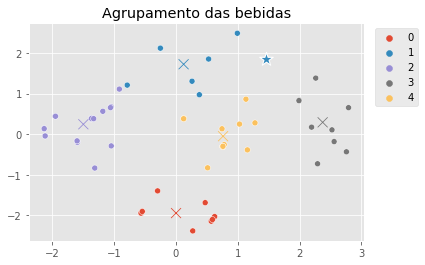

In [68]:
plt.title('Agrupamento das bebidas')
ax = sns.scatterplot(x=components[:,0], y=components[:,1], hue=knn.labels_, palette=palette)
ax = sns.scatterplot(x=knn.cluster_centers_[:,0], y=knn.cluster_centers_[:,1], hue=range(knn.n_clusters), s=100, palette=palette, legend=False, ax=ax, marker='x')
sns.scatterplot(x=component_novo[:,0], y=component_novo[:,1], hue=label, palette=palette, s=200, ax=ax, marker='*', legend=False)
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left')
plt.show()